In [1]:
import pandas as pd
import numpy as np
from statsmodels.tsa.stattools import adfuller
import plotly.express as px
import plotly.graph_objects as go
from statsmodels.tsa.stattools import pacf, acf
from datetime import datetime

In [3]:
def create_corr_plot(series, plot_pacf=False):
    corr_array = pacf(series.dropna(), alpha=0.05) if plot_pacf else acf(series.dropna(), alpha=0.05)
    lower_y = corr_array[1][:,0] - corr_array[0]
    upper_y = corr_array[1][:,1] - corr_array[0]

    fig = go.Figure()
    [fig.add_scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='#3f3f3f') 
     for x in range(len(corr_array[0]))]
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=corr_array[0], mode='markers', marker_color='#1f77b4',
                   marker_size=12)
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=upper_y, mode='lines', line_color='rgba(255,255,255,0)')
    fig.add_scatter(x=np.arange(len(corr_array[0])), y=lower_y, mode='lines',fillcolor='rgba(32, 146, 230,0.3)',
            fill='tonexty', line_color='rgba(255,255,255,0)')
    fig.update_traces(showlegend=False)
    fig.update_xaxes(range=[-1,42])
    fig.update_yaxes(zerolinecolor='#000000')
    
    title='Partial Autocorrelation (PACF)' if plot_pacf else 'Autocorrelation (ACF)'
    fig.update_layout(title=title)
    fig.show()

In [2]:
df_gmc = pd.read_csv('../data/gmc/sigesguarda_cleaned.csv')
df_gmc['OCORRENCIA_DATA_SEM_HORARIO'] = pd.to_datetime(df_gmc['OCORRENCIA_DATA'], format='%Y-%m-%d %H:%M:%S.%f').dt.date

df_gmc.sample(5)

/home/radek/TCC/venv/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3397: DtypeWarning: Columns (15,19,20,33) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


,ATENDIMENTO_ANO,ATENDIMENTO_BAIRRO_NOME,EQUIPAMENTO_URBANO_NOME,FLAG_EQUIPAMENTO_URBANO,FLAG_FLAGRANTE,LOGRADOURO_NOME,NATUREZA1_DEFESA_CIVIL,NATUREZA1_DESCRICAO,NATUREZA2_DEFESA_CIVIL,NATUREZA2_DESCRICAO,...,OPERACAO_DESCRICAO,ORIGEM_CHAMADO_DESCRICAO,REGIONAL_FATO_NOME,SECRETARIA_NOME,SECRETARIA_SIGLA,SERVICO_NOME,SITUACAO_EQUIPE_DESCRICAO,NUMERO_PROTOCOLO_156,OCORRENCIA_DATA_SEM_HORARIO,FERIADO
230298,2018,BACACHERI,UNIDADE DE PRONTO ATENDIMENTO BOA VISTA,SIM,NÃO,PARANÁ,0,Achado,NaN,NaN,...,NORMAL,IMEDIATA,BOA VISTA,SECRETARIA MUNICIPAL DA SAÚDE,SMS,NORMAL,Deslocamento,NaN,2018-12-12,0
82537,2012,CENTRO,NaN,NÃO,NÃO,RUI BARBOSA,0,Apoio,NaN,NaN,...,NaN,"VAZIO ""NÃO CADASTRAR"" ANTIGO AOS GMS",MATRIZ,SECRETARIA MUNICIPAL DE DEFESA SOCIAL E TRANSITO,SMDT,GUARDA DO CENTRO,NaN,NaN,2012-09-11,0
179661,2016,CENTRO,NaN,NÃO,NÃO,NUNES MACHADO,0,Agressão física/verbal,NaN,NaN,...,NORMAL,"VAZIO ""NÃO CADASTRAR"" ANTIGO AOS GMS",MATRIZ,SECRETARIA MUNICIPAL DE DEFESA SOCIAL E TRANSITO,SMDT,GTM (Motos),Solicitação,NaN,2016-09-18,0
144539,2015,CAPAO RASO,RUA DA CIDADANIA PINHEIRINHO,SIM,NÃO,WINSTON CHURCHILL,0,Atitude Suspeita,NaN,NaN,...,NORMAL,IMEDIATA,PINHEIRINHO,SECRETARIA MUNICIPAL DE DEFESA SOCIAL E TRANSITO,SMDT,NORMAL,Deslocamento,NaN,2015-04-02,0
199388,2017,PORTAO,TERMINAL PORTÃO,SIM,NÃO,REPÚBLICA ARGENTINA,0,Atitude Suspeita,NaN,NaN,...,NORMAL,153,PORTÃO,URBANIZAÇÃO DE CURITIBA,URBS,NORMAL,Solicitação,NaN,2017-08-18,0


In [5]:
df_series = df_gmc[['ATENDIMENTO_ANO','ATENDIMENTO_BAIRRO_NOME','OCORRENCIA_ANO','OCORRENCIA_DATA','OCORRENCIA_DIA_SEMANA','OCORRENCIA_MES','NATUREZA1_DESCRICAO']].copy()

df_series['OCORRENCIA_DATA'] = pd.to_datetime(df_series['OCORRENCIA_DATA'], format='%Y-%m-%d %H:%M:%S.%f')
df_series['OCORRENCIA_DIA'] = df_series['OCORRENCIA_DATA'].apply(lambda x: x.day)
df_series['OCORRENCIA_HORA'] = df_series['OCORRENCIA_DATA'].apply(lambda x: x.hour)
df_series['OCORRENCIA_MINUTO'] = df_series['OCORRENCIA_DATA'].apply(lambda x: x.minute)

df_series = df_series[['ATENDIMENTO_ANO','OCORRENCIA_DIA','OCORRENCIA_MES','OCORRENCIA_ANO','OCORRENCIA_DIA_SEMANA','OCORRENCIA_HORA','OCORRENCIA_MINUTO','ATENDIMENTO_BAIRRO_NOME','NATUREZA1_DESCRICAO']]
df_series.tail()

,ATENDIMENTO_ANO,OCORRENCIA_DIA,OCORRENCIA_MES,OCORRENCIA_ANO,OCORRENCIA_DIA_SEMANA,OCORRENCIA_HORA,OCORRENCIA_MINUTO,ATENDIMENTO_BAIRRO_NOME,NATUREZA1_DESCRICAO
389959,2022,28,2,2022,SEGUNDA,22,0,BATEL,Atitude Suspeita (Abordagem)
389960,2022,28,2,2022,SEGUNDA,22,19,CENTRO,Apoio
389961,2022,28,2,2022,SEGUNDA,22,58,CAJURU,Apoio
389962,2022,28,2,2022,SEGUNDA,22,40,SITIO CERCADO,Furto
389963,2022,28,2,2022,SEGUNDA,23,29,CAPAO RASO,Apoio


In [6]:
df_alltime = df_gmc.groupby(['OCORRENCIA_DATA_SEM_HORARIO']).size().reset_index(name='OCORRENCIAS_ATENDIDAS')
df_alltime.head()

,OCORRENCIA_DATA_SEM_HORARIO,OCORRENCIAS_ATENDIDAS
0,2009-01-01,30
1,2009-01-02,81
2,2009-01-03,96
3,2009-01-04,93
4,2009-01-05,59


In [7]:
px.line(df_alltime,x='OCORRENCIA_DATA_SEM_HORARIO',y='OCORRENCIAS_ATENDIDAS')

# ARIMA Model

In [ ]:
def adfuller_test(series,diff=False):
    if diff:
        series = series.diff()[1:]
    result = adfuller(np.array(series))
    print('ADF Statistic: {}'.format(result[0]))
    print('p-value: {}'.format(result[1]))

adfuller_test(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze(), True)

In [ ]:
create_corr_plot(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze(), plot_pacf=True)

In [ ]:
create_corr_plot(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze())

In [ ]:
from statsmodels.tsa.arima.model import ARIMA

In [ ]:

series = np.array(df_alltime['OCORRENCIAS_ATENDIDAS'].squeeze())
arima_model = ARIMA(series, order=(2,2,7))
model = arima_model.fit()
print(model.summary())

/home/radek/TCC/venv/lib/python3.8/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/home/radek/TCC/venv/lib/python3.8/site-packages/statsmodels/base/model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                 4807
Model:                 ARIMA(2, 2, 7)   Log Likelihood              -21532.192
Date:                Mon, 21 Nov 2022   AIC                          43084.384
Time:                        13:57:37   BIC                          43149.158
Sample:                             0   HQIC                         43107.132
                               - 4807                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.8009      0.002   -961.473      0.000      -1.805      -1.797
ar.L2         -0.9979      0.002   -515.472      0.000      -1.002      -0.994
ma.L1          0.2155      0.007     29.112      0.0

In [ ]:
df_result = pd.DataFrame([series,model.predict(start=0,end=10000)]).transpose().reset_index().rename(columns={0:'Real',1:'Predito'})
px.line(df_result,x='index',y=df_result.columns)

## Regression Model

In [3]:
from statsmodels.regression.linear_model import OLS
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
import statsmodels.formula.api as smf
import math

In [ ]:
def evaluate_ols(results, X, y):
    print(f'params:\n{results.params}\n')
    print(f'rsquared:\n{results.rsquared}\n')
    print(f'rsquared_adj:\n{results.rsquared_adj}\n')
    print(f'mse:\n{mean_squared_error(y, results.predict(X))}\n')
    print(f'rmse:\n{math.sqrt(mean_squared_error(y, results.predict(X)))}\n')
    print(f'mae:\n{mean_absolute_error(y, results.predict(X))}')

In [4]:
df_gmc_ols_model = df_gmc
df_gmc_ols_model = df_gmc_ols_model.groupby(['OCORRENCIA_DATA_SEM_HORARIO','FERIADO']).size().reset_index(name='OCORRENCIAS_ATENDIDAS')
df_gmc_ols_model['x0_final_de_semana'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: 1 if x.weekday() == 5 or x.weekday() == 6 else 0)
df_gmc_ols_model['x1_time'] = np.arange(df_gmc_ols_model.shape[0])
df_gmc_ols_model['x2_lag1'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(1).fillna(0)
df_gmc_ols_model['x3_lag2'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(2).fillna(0)
df_gmc_ols_model['x4_lag3'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(3).fillna(0)
df_gmc_ols_model['x5_lag4'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(4).fillna(0)
df_gmc_ols_model['x6_lag5'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(5).fillna(0)
df_gmc_ols_model['x7_lag6'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(6).fillna(0)
df_gmc_ols_model['x8_lag7'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(7).fillna(0)
df_gmc_ols_model['x9_window_mean'] = df_gmc_ols_model['OCORRENCIAS_ATENDIDAS'].shift(1).rolling(window=7).mean().fillna(0)
df_gmc_ols_model['x10_feriado'] = df_gmc_ols_model['FERIADO']
df_gmc_ols_model['x11_pandemia'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: 1 if x >= datetime.strptime('11/03/2020','%d/%m/%Y').date() else 0)
df_gmc_ols_model['x12_dia_semana'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: x.weekday())
df_gmc_ols_model

,OCORRENCIA_DATA_SEM_HORARIO,FERIADO,OCORRENCIAS_ATENDIDAS,x0_final_de_semana,x1_time,x2_lag1,x3_lag2,x4_lag3,x5_lag4,x6_lag5,x7_lag6,x8_lag7,x9_window_mean,x10_feriado,x11_pandemia,x12_dia_semana
0,2009-01-01,1,30,0,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,1,0,3
1,2009-01-02,0,81,0,1,30.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0,0,4
2,2009-01-03,0,96,1,2,81.0,30.0,0.0,0.0,0.0,0.0,0.0,0.000000,0,0,5
3,2009-01-04,0,93,1,3,96.0,81.0,30.0,0.0,0.0,0.0,0.0,0.000000,0,0,6
4,2009-01-05,0,59,0,4,93.0,96.0,81.0,30.0,0.0,0.0,0.0,0.000000,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4802,2022-02-24,0,166,0,4802,150.0,173.0,150.0,135.0,166.0,143.0,183.0,157.142857,0,1,3
4803,2022-02-25,0,143,0,4803,166.0,150.0,173.0,150.0,135.0,166.0,143.0,154.714286,0,1,4
4804,2022-02-26,0,142,1,4804,143.0,166.0,150.0,173.0,150.0,135.0,166.0,154.714286,0,1,5
4805,2022-02-27,0,143,1,4805,142.0,143.0,166.0,150.0,173.0,150.0,135.0,151.285714,0,1,6


### Model 1

In [ ]:
X_model1, y_model1 = df_gmc_ols_model[['x1_time']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model1 = OLS(y_model1, X_model1)
results1 = model1.fit()

results1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.804
Model:                               OLS   Adj. R-squared (uncentered):              0.804
Method:                    Least Squares   F-statistic:                          1.966e+04
Date:                   Mon, 21 Nov 2022   Prob (F-statistic):                        0.00
Time:                           13:57:38   Log-Likelihood:                         -24660.
No. Observations:                   4807   AIC:                                  4.932e+04
Df Residuals:                       4806   BIC:                                  4.933e+04
Df Model:                              1                                                  
Covariance Type:               nonrobust                                                  
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
x1_time        0.0298      0.000    140.205      0.000       0.029       0.030
==============================================================================
Omnibus:                     1708.335   Durbin-Watson:                   0.385
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            15118.775
Skew:                           1.443   Prob(JB):                         0.00
Kurtosis:                      11.194   Cond. No.                         1.00
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [ ]:
df_results1 = pd.DataFrame([y_model1, results1.predict(X_model1)]).transpose().reset_index()
px.line(df_results1,x='index',y=df_results1.columns)

### Model 2

In [ ]:
X_model2, y_model2 = df_gmc_ols_model[['x1_time','x0_final_de_semana']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model2 = OLS(y_model2, X_model2)
results2 = model2.fit()

results2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.818
Model:                               OLS   Adj. R-squared (uncentered):              0.818
Method:                    Least Squares   F-statistic:                          1.081e+04
Date:                   Mon, 21 Nov 2022   Prob (F-statistic):                        0.00
Time:                           13:57:39   Log-Likelihood:                         -24473.
No. Observations:                   4807   AIC:                                  4.895e+04
Df Residuals:                       4805   BIC:                                  4.896e+04
Df Model:                              2                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x1_time                0.0277      0.000    120.050      0.000       0.027       0.028
x0_final_de_semana    23.5776      1.198     19.686      0.000      21.230      25.926
==============================================================================
Omnibus:                     1710.486   Durbin-Watson:                   0.410
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            18721.552
Skew:                           1.379   Prob(JB):                         0.00
Kurtosis:                      12.266   Cond. No.                     5.86e+03
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 5.86e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
df_results2 = pd.DataFrame([y_model2,results2.predict(X_model2)]).transpose().reset_index()
px.line(df_results2,x='index',y=df_results2.columns)

### Model 3

In [ ]:
X_model3, y_model3 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x10_feriado']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model3 = OLS(y_model3, X_model3)
results3 = model3.fit()

results3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.818
Model:                               OLS   Adj. R-squared (uncentered):              0.818
Method:                    Least Squares   F-statistic:                              7214.
Date:                   Mon, 21 Nov 2022   Prob (F-statistic):                        0.00
Time:                           13:57:39   Log-Likelihood:                         -24471.
No. Observations:                   4807   AIC:                                  4.895e+04
Df Residuals:                       4804   BIC:                                  4.897e+04
Df Model:                              3                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana    23.6053      1.197     19.713      0.000      21.258      25.953
x1_time                0.0276      0.000    118.542      0.000       0.027       0.028
x10_feriado            6.2411      3.169      1.970      0.049       0.029      12.453
==============================================================================
Omnibus:                     1715.570   Durbin-Watson:                   0.410
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            18893.936
Skew:                           1.382   Prob(JB):                         0.00
Kurtosis:                      12.311   Cond. No.                     1.55e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.55e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
df_results3 = pd.DataFrame([y_model3, results3.predict(X_model3)]).transpose().reset_index()
df_results3['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
px.line(df_results3,x='Data',y=df_results3.columns[1:3])

## Model 4

In [ ]:
X_model4, y_model4 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x10_feriado','x11_pandemia']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model4 = OLS(y_model4, X_model4)
results4 = model4.fit()

results4.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.847
Model:                               OLS   Adj. R-squared (uncentered):              0.847
Method:                    Least Squares   F-statistic:                              6652.
Date:                   Mon, 21 Nov 2022   Prob (F-statistic):                        0.00
Time:                           13:57:40   Log-Likelihood:                         -24057.
No. Observations:                   4807   AIC:                                  4.812e+04
Df Residuals:                       4803   BIC:                                  4.815e+04
Df Model:                              4                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana    27.4507      1.106     24.817      0.000      25.282      29.619
x1_time                0.0228      0.000     84.851      0.000       0.022       0.023
x10_feriado            9.6469      2.910      3.315      0.001       3.942      15.351
x11_pandemia          51.9131      1.727     30.051      0.000      48.526      55.300
==============================================================================
Omnibus:                     1842.138   Durbin-Watson:                   0.510
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            35325.836
Skew:                           1.343   Prob(JB):                         0.00
Kurtosis:                      16.006   Cond. No.                     1.55e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.55e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
df_results4 = pd.DataFrame([y_model4, results4.predict(X_model4)]).transpose().reset_index()
df_results4['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
px.line(df_results4,x='Data',y=df_results4.columns[1:3])

## Model 5

In [8]:
X_model5, y_model5 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x2_lag1','x3_lag2','x5_lag4','x7_lag6','x8_lag7','x11_pandemia']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model5 = OLS(y_model5, X_model5)
results5 = model5.fit()

results5.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.951
Model:                               OLS   Adj. R-squared (uncentered):              0.951
Method:                    Least Squares   F-statistic:                          1.154e+04
Date:                   Mon, 21 Nov 2022   Prob (F-statistic):                        0.00
Time:                           15:19:42   Log-Likelihood:                         -21342.
No. Observations:                   4807   AIC:                                  4.270e+04
Df Residuals:                       4799   BIC:                                  4.275e+04
Df Model:                              8                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana     8.7038      0.688     12.652      0.000       7.355      10.053
x1_time                0.0012      0.000      4.610      0.000       0.001       0.002
x2_lag1                0.3650      0.014     26.298      0.000       0.338       0.392
x3_lag2                0.1010      0.014      7.351      0.000       0.074       0.128
x5_lag4                0.0936      0.013      7.446      0.000       0.069       0.118
x7_lag6                0.1937      0.014     14.021      0.000       0.167       0.221
x8_lag7                0.1661      0.014     11.659      0.000       0.138       0.194
x11_pandemia           4.9368      1.089      4.535      0.000       2.803       7.071
==============================================================================
Omnibus:                     5044.507   Durbin-Watson:                   1.949
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          2214031.405
Skew:                           4.519   Prob(JB):                         0.00
Kurtosis:                     107.749   Cond. No.                     1.04e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.04e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [5]:
df_gmc_ols_model[['x0_final_de_semana','x1_time','x2_lag1','x3_lag2','x5_lag4','x7_lag6','x8_lag7','x11_pandemia','OCORRENCIAS_ATENDIDAS']].to_csv('./gmc_temporal_prepared.csv',index=False)

In [9]:
df_results5 = pd.DataFrame([y_model5, results5.predict(X_model5)]).transpose().reset_index()
df_results5['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
df_results5.rename(columns={'Unnamed 0':'OCORRENCIAS_PREVISTAS'},inplace=True)
px.line(df_results5,x='Data',y=df_results5.columns[1:3])

## Model 6

In [ ]:
X_model6, y_model6 = df_gmc_ols_model[['x0_final_de_semana','x1_time','x2_lag1','x3_lag2','x4_lag3','x5_lag4','x6_lag5','x7_lag6','x8_lag7','x9_window_mean','x10_feriado','x11_pandemia']], df_gmc_ols_model['OCORRENCIAS_ATENDIDAS']

model6 = OLS(y_model6, X_model6)
results6 = model6.fit()

results6.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                  
==========================================================================================
Dep. Variable:     OCORRENCIAS_ATENDIDAS   R-squared (uncentered):                   0.951
Model:                               OLS   Adj. R-squared (uncentered):              0.951
Method:                    Least Squares   F-statistic:                              7703.
Date:                   Mon, 21 Nov 2022   Prob (F-statistic):                        0.00
Time:                           13:57:41   Log-Likelihood:                         -21338.
No. Observations:                   4807   AIC:                                  4.270e+04
Df Residuals:                       4795   BIC:                                  4.278e+04
Df Model:                             12                                                  
Covariance Type:               nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
x0_final_de_semana     8.6375      0.703     12.294      0.000       7.260      10.015
x1_time                0.0013      0.000      4.741      0.000       0.001       0.002
x2_lag1                0.4440      0.034     12.972      0.000       0.377       0.511
x3_lag2                0.1841      0.034      5.338      0.000       0.116       0.252
x4_lag3                0.0578      0.035      1.674      0.094      -0.010       0.125
x5_lag4                0.1787      0.035      5.151      0.000       0.111       0.247
x6_lag5                0.0762      0.035      2.179      0.029       0.008       0.145
x7_lag6                0.2721      0.035      7.750      0.000       0.203       0.341
x8_lag7                0.2474      0.035      6.996      0.000       0.178       0.317
x9_window_mean        -0.5429      0.221     -2.457      0.014      -0.976      -0.110
x10_feriado            1.2220      1.657      0.737      0.461      -2.027       4.471
x11_pandemia           5.0421      1.090      4.625      0.000       2.905       7.180
==============================================================================
Omnibus:                     5044.583   Durbin-Watson:                   1.953
Prob(Omnibus):                  0.000   Jarque-Bera (JB):          2228783.538
Skew:                           4.517   Prob(JB):                         0.00
Kurtosis:                     108.100   Cond. No.                     1.56e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.56e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
df_results6 = pd.DataFrame([y_model6, results6.predict(X_model6)]).transpose().reset_index()
df_results6['Data'] = df_gmc_ols_model['OCORRENCIA_DATA_SEM_HORARIO']
px.line(df_results6,x='Data',y=df_results6.columns[1:3])

## Outliers baseado em resíduos

In [10]:
df_results5.drop(columns=['index'],inplace=True)
df_results5.rename(columns={'OCORRENCIAS_ATENDIDAS':'Atendidas','OCORRENCIAS_PREVISTAS':'Previstas'},inplace=True)
df_results5['Previstas'] = df_results5['Previstas'].astype(int)

In [11]:
df_results5['ERRO'] = df_results5['Previstas'] - df_results5['Atendidas']
df_results5['Z-SCORE'] = (df_results5['ERRO'] - df_results5['ERRO'].mean())/df_results5['ERRO'].std()
df_results5['OUTLIER'] = df_results5['Z-SCORE'].apply(lambda x: 1 if abs(x) >= 2.17 else 0)
df_results5

,Atendidas,Previstas,Data,ERRO,Z-SCORE,OUTLIER
0,30.0,0,2009-01-01,-30.0,-1.415732,0
1,81.0,10,2009-01-02,-71.0,-3.414817,1
2,96.0,41,2009-01-03,-55.0,-2.634686,1
3,93.0,51,2009-01-04,-42.0,-2.000830,0
4,59.0,46,2009-01-05,-13.0,-0.586843,0
...,...,...,...,...,...,...
4802,166.0,153,2022-02-24,-13.0,-0.586843,0
4803,143.0,156,2022-02-25,13.0,0.680870,0
4804,142.0,158,2022-02-26,16.0,0.827144,0
4805,143.0,151,2022-02-27,8.0,0.437079,0


In [16]:
df_gmc_ols_model.assign(outlier=df_results5['OUTLIER'].values)[['x0_final_de_semana','x1_time','OCORRENCIA_DATA_SEM_HORARIO','x2_lag1','x3_lag2','x5_lag4','x7_lag6','x8_lag7','x11_pandemia','OCORRENCIAS_ATENDIDAS','outlier']].to_csv('./gmc_temporal_prepared.csv',index=False)

In [31]:
import plotly.express as px
import plotly.graph_objects as go

fig1 = px.line(df_results5, x='Data', y=['Atendidas','Previstas'])
fig1.data[0].line.color = 'rgba(135, 148, 168, .85)'
fig1.data[1].line.color = 'rgba(75, 83, 94, 1)'

fig2 = px.scatter(df_results5[df_results5['OUTLIER'] == 1], x='Data', y='Atendidas', color_discrete_sequence=['rgba(75, 83, 94, 1)'])
fig2['data'][0]['showlegend'] = True
fig2['data'][0]['name'] = 'Outlier'

fig3 = go.Figure(data=fig1.data + fig2.data)
fig3.show()

## LISA/Moran

In [32]:
# Graphics
import matplotlib.pyplot as plt
import seaborn
from pysal.viz import splot
from splot.esda import plot_moran

# Analysis
import geopandas as gpd
from pysal.explore import esda
from pysal.lib import weights
from numpy.random import seed

continuous_rdbu_scale = ['rgba(6, 50, 100, 1)', 'rgba(57, 134, 188, 1)', 'rgba(156, 202, 225, 1)', 'rgba(240, 156, 123, 1)', 'rgba(182, 32, 47, 1)', 'rgba(103, 0, 31, 1)']

/home/radek/TCC/venv/lib/python3.8/site-packages/geopandas/_compat.py:111: UserWarning:

The Shapely GEOS version (3.10.3-CAPI-1.16.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.

/home/radek/TCC/venv/lib/python3.8/site-packages/spaghetti/network.py:36: FutureWarning:

The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.



In [33]:
ref = df_gmc.groupby(['ATENDIMENTO_BAIRRO_NOME']).size().reset_index(name='OCORRENCIAS_ATENDIDAS').set_index('ATENDIMENTO_BAIRRO_NOME')

dem = pd.read_csv('../data/renda.csv')
dem = dem[['Bairros','População Total']].set_index('Bairros')
ref = ref.join(dem)

ref.dropna(inplace=True)
ref['OCORRENCIAS_ATENDIDAS_PER_CAPITA'] = ref['OCORRENCIAS_ATENDIDAS'] / ref['População Total']
ref.drop(columns=['OCORRENCIAS_ATENDIDAS','População Total'],inplace=True)
ref.info()

<class 'pandas.core.frame.DataFrame'>
Index: 74 entries, ABRANCHES to XAXIM
Data columns (total 1 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   OCORRENCIAS_ATENDIDAS_PER_CAPITA  74 non-null     float64
dtypes: float64(1)
memory usage: 1.2+ KB


In [34]:
bairros = gpd.read_file('../data/divisa_bairros_cleaned.geojson').set_index('NOME')
bairros.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 75 entries, AGUA VERDE to SANTA FELICIDADE
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   OBJECTID    75 non-null     int64   
 1   CODIGO      75 non-null     int64   
 2   TIPO        75 non-null     object  
 3   FONTE       75 non-null     object  
 4   CD_REGIONA  75 non-null     int64   
 5   NM_REGIONA  75 non-null     object  
 6   SHAPE_AREA  75 non-null     float64 
 7   SHAPE_LEN   75 non-null     float64 
 8   geometry    75 non-null     geometry
dtypes: float64(2), geometry(1), int64(3), object(3)
memory usage: 5.9+ KB


In [35]:
db = gpd.GeoDataFrame(bairros.join(ref[["OCORRENCIAS_ATENDIDAS_PER_CAPITA"]]), crs=bairros.crs).to_crs(epsg=3857)[["OCORRENCIAS_ATENDIDAS_PER_CAPITA", "geometry"]].dropna()
db.tail()

,OCORRENCIAS_ATENDIDAS_PER_CAPITA,geometry
NOME,,
SANTO INACIO,1.033957,"POLYGON ((-5490638.725 -2927646.697, -5490639...."
VISTA ALEGRE,0.139577,"POLYGON ((-5488456.296 -2924500.831, -5488501...."
SAO BRAZ,0.103984,"POLYGON ((-5493045.709 -2925482.796, -5493099...."
CASCATINHA,0.159146,"POLYGON ((-5488683.456 -2925644.261, -5488690...."
SANTA FELICIDADE,0.230513,"POLYGON ((-5490141.739 -2924318.296, -5490171...."


In [36]:
# Generate W from the GeoDataFrame
w = weights.KNN.from_dataframe(db, k=6)
# Row-standardization
w.transform = "R"

In [37]:
db["Occorencias_per_capita_lag"] = weights.spatial_lag.lag_spatial(w, db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"])

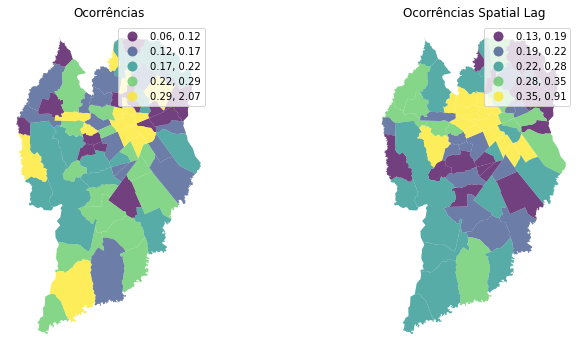

In [38]:
f, axs = plt.subplots(1, 2, figsize=(12, 6))
ax1, ax2 = axs

db.plot(
    column="OCORRENCIAS_ATENDIDAS_PER_CAPITA",
    cmap="viridis",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=ax1,
)
ax1.set_axis_off()
ax1.set_title("Ocorrências")
# contextily.add_basemap(
#     ax1,
#     crs=db.crs,
#     source=contextily.providers.Stamen.TerrainBackground,
# )

db.plot(
    column="Occorencias_per_capita_lag",
    cmap="viridis",
    scheme="quantiles",
    k=5,
    edgecolor="white",
    linewidth=0.0,
    alpha=0.75,
    legend=True,
    ax=ax2,
)
ax2.set_axis_off()
ax2.set_title("Ocorrências Spatial Lag")
# contextily.add_basemap(
#     ax2,
#     crs=db.crs,
#     source=contextily.providers.Stamen.TerrainBackground,
# )

plt.show()

In [39]:
db["Ocorrencias_std"] = db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"] - db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"].mean()
db["Ocorrencias_lag_std"] = db["Occorencias_per_capita_lag"] - db["Occorencias_per_capita_lag"].mean()

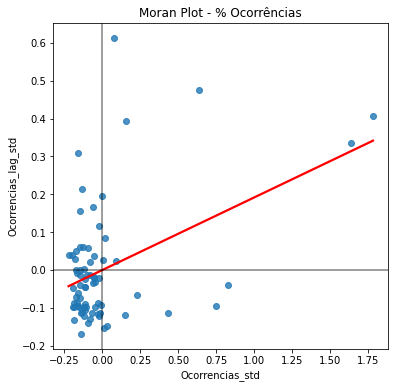

In [40]:
f, ax = plt.subplots(1, figsize=(6, 6))
seaborn.regplot(
    x="Ocorrencias_std",
    y="Ocorrencias_lag_std",
    ci=None,
    data=db,
    line_kws={"color": "r"},
)
ax.axvline(0, c="k", alpha=0.5)
ax.axhline(0, c="k", alpha=0.5)
ax.set_title("Moran Plot - % Ocorrências")
plt.show()

In [41]:
moran = esda.moran.Moran(db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"], w)
print('Moran\'s I: ', moran.I)
print('Moran\'s p: ', moran.p_sim)

Moran's I:  0.19163344441808067
Moran's p:  0.005


In [42]:
lisa = esda.moran.Moran_Local(db["OCORRENCIAS_ATENDIDAS_PER_CAPITA"], w)

In [43]:
spots_labels = {
    0: "Non-Significant",
    1: "HH",
    2: "LH",
    3: "LL",
    4: "HL",
}

db['labels'] = pd.Series(
    # First initialise a Series using values and `db` index
    ((1*(lisa.p_sim < 0.05)) * (lisa.q)),
    index=db.index
    # Then map each value to corresponding label based
    # on the `spots_labels` mapping
).map(spots_labels)

db.reset_index(inplace=True)
db.tail()

,NOME,OCORRENCIAS_ATENDIDAS_PER_CAPITA,geometry,Occorencias_per_capita_lag,Ocorrencias_std,Ocorrencias_lag_std,labels
69,SANTO INACIO,1.033957,"POLYGON ((-5490638.725 -2927646.697, -5490639....",0.201849,0.747565,-0.094735,Non-Significant
70,VISTA ALEGRE,0.139577,"POLYGON ((-5488456.296 -2924500.831, -5488501....",0.453673,-0.146815,0.157090,Non-Significant
71,SAO BRAZ,0.103984,"POLYGON ((-5493045.709 -2925482.796, -5493099....",0.326870,-0.182409,0.030287,Non-Significant
72,CASCATINHA,0.159146,"POLYGON ((-5488683.456 -2925644.261, -5488690....",0.358557,-0.127246,0.061973,Non-Significant
73,SANTA FELICIDADE,0.230513,"POLYGON ((-5490141.739 -2924318.296, -5490171....",0.277070,-0.055879,-0.019513,Non-Significant


In [44]:
db['labels'] = pd.Series(lisa.q,index=db.index).map(spots_labels)
db['labels_sig'] = pd.Series(1*(lisa.p_sim < 0.05)*lisa.q,index=db.index).map(spots_labels)

In [45]:
import json

f = open('../data/divisa_bairros_cleaned.geojson', encoding='utf-8')

bairros_geojson = json.load(f)

In [46]:
fig = px.choropleth_mapbox(db, geojson=bairros_geojson, color="labels",color_continuous_scale=(
                        ['rgba(6, 50, 100, 1)', 'rgba(57, 134, 188, 1)', 'rgba(156, 202, 225, 1)', 
                        'rgba(240, 156, 123, 1)', 'rgba(182, 32, 47, 1)', 'rgba(103, 0, 31, 1)']),
                           locations="NOME", featureidkey='properties.NOME',
                           center={"lat": -25.459717, "lon": -49.278820},
                           mapbox_style="carto-positron", zoom=9)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0}, width=600)
fig.show()

In [47]:
from splot import esda as esdaplot

(<Figure size 929.032x953.642 with 1 Axes>, <AxesSubplot:>)

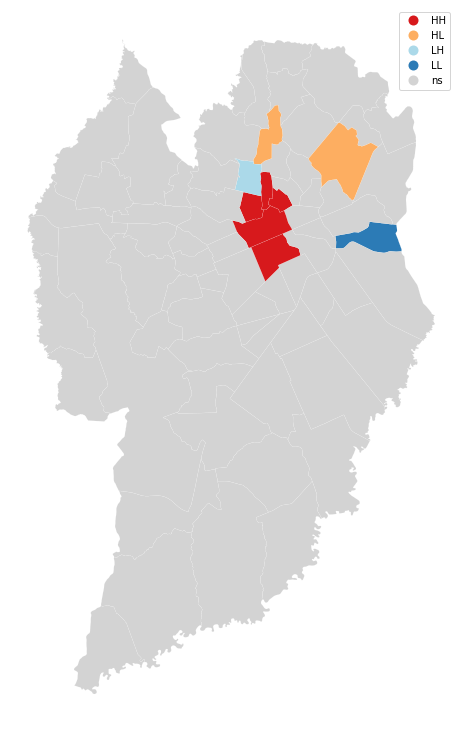

In [48]:
ax = plt.gca()

def set_size(w,h, ax=None):
    """ w, h: width, height in inches """
    if not ax: ax=plt.gca()
    l = ax.figure.subplotpars.left
    r = ax.figure.subplotpars.right
    t = ax.figure.subplotpars.top
    b = ax.figure.subplotpars.bottom
    figw = float(w)/(r-l)
    figh = float(h)/(t-b)
    ax.figure.set_size_inches(figw, figh)

set_size(10,10,ax)

esdaplot.lisa_cluster(lisa, db, p=.05, ax=ax)

In [49]:
lisa.q

array([3, 3, 3, 2, 3, 3, 1, 1, 3, 3, 3, 2, 1, 2, 3, 3, 3, 2, 1, 3, 3, 3,
       1, 3, 2, 2, 1, 2, 3, 2, 1, 4, 2, 3, 3, 3, 3, 3, 2, 4, 4, 2, 2, 3,
       3, 3, 3, 3, 3, 1, 3, 2, 3, 4, 3, 3, 3, 3, 3, 4, 3, 2, 3, 4, 2, 3,
       3, 3, 2, 4, 2, 2, 2, 3])

## Espaço-temporal

In [50]:
import statsmodels.formula.api as smf

In [51]:
gmc_bairro_mes = df_gmc.groupby(by=['OCORRENCIA_ANO','OCORRENCIA_MES','ATENDIMENTO_BAIRRO_NOME']).size().reset_index(name='OCORRENCIAS')

In [52]:
def create_lag_feature(dataframe,feature_lag_name,lag=1):
    for idx, bairro in enumerate(dataframe['ATENDIMENTO_BAIRRO_NOME'].value_counts().index):
        bairro_slice = dataframe[dataframe['ATENDIMENTO_BAIRRO_NOME'] == bairro].sort_values(by=['OCORRENCIA_ANO','OCORRENCIA_MES'])
        shifted_values = bairro_slice['OCORRENCIAS'].shift(lag,fill_value=0)
        for idx in bairro_slice.index:
            dataframe.loc[idx,feature_lag_name] = shifted_values.loc[idx]

In [53]:

create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG1',1)
create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG2',2)
create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG3',3)
create_lag_feature(gmc_bairro_mes,'OCORRENCIAS_LAG4',4)

In [54]:
# gmc_bairro_mes.to_csv('ocorrencias_bairro_mes.csv',index=False)

## Model 1 

In [55]:
gmc_bairro_mes

,OCORRENCIA_ANO,OCORRENCIA_MES,ATENDIMENTO_BAIRRO_NOME,OCORRENCIAS,OCORRENCIAS_LAG1,OCORRENCIAS_LAG2,OCORRENCIAS_LAG3,OCORRENCIAS_LAG4
0,2009,1,ABRANCHES,14,0.0,0.0,0.0,0.0
1,2009,1,AGUA VERDE,29,0.0,0.0,0.0,0.0
2,2009,1,AHU,6,0.0,0.0,0.0,0.0
3,2009,1,ALTO BOQUEIRAO,46,0.0,0.0,0.0,0.0
4,2009,1,ALTO DA GLORIA,5,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
11586,2022,2,UBERABA,66,63.0,69.0,83.0,81.0
11587,2022,2,UMBARA,20,18.0,25.0,20.0,16.0
11588,2022,2,VILA IZABEL,16,24.0,26.0,16.0,16.0
11589,2022,2,VISTA ALEGRE,12,19.0,15.0,12.0,12.0


In [56]:
f1 = 'OCORRENCIAS ~ OCORRENCIA_ANO + OCORRENCIA_MES + ATENDIMENTO_BAIRRO_NOME - 1'

In [57]:
stm1 = smf.ols(f1, data=gmc_bairro_mes).fit()

In [58]:
stm1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            OCORRENCIAS   R-squared:                       0.653
Model:                            OLS   Adj. R-squared:                  0.647
Method:                 Least Squares   F-statistic:                     123.2
Date:                Mon, 21 Nov 2022   Prob (F-statistic):               0.00
Time:                        13:58:46   Log-Likelihood:                -59639.
No. Observations:               11591   AIC:                         1.196e+05
Df Residuals:                   11416   BIC:                         1.209e+05
Df Model:                         174                                         
Covariance Type:            nonrobust                                         
==========================================================================================================================
                                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------------------
ATENDIMENTO_BAIRRO_NOME[ABRANCHES]                     -5505.3847    207.033    -26.592      0.000   -5911.205   -5099.564
ATENDIMENTO_BAIRRO_NOME[AFONSO PENA]                   -5532.9583    209.725    -26.382      0.000   -5944.054   -5121.862
ATENDIMENTO_BAIRRO_NOME[AGUA VERDE]                    -5473.0113    207.033    -26.435      0.000   -5878.832   -5067.191
ATENDIMENTO_BAIRRO_NOME[AGUAS BELAS]                   -5526.3936    209.506    -26.378      0.000   -5937.061   -5115.726
ATENDIMENTO_BAIRRO_NOME[AHU]                           -5512.9883    207.029    -26.629      0.000   -5918.801   -5107.176
ATENDIMENTO_BAIRRO_NOME[ALTO BOQUEIRAO]                -5461.3910    207.033    -26.379      0.000   -5867.211   -5055.571
ATENDIMENTO_BAIRRO_NOME[ALTO DA GLORIA]                -5504.9100    207.033    -26.590      0.000   -5910.730   -5099.090
ATENDIMENTO_BAIRRO_NOME[ALTO DA RUA XV]                -5501.7707    207.033    -26.574      0.000   -5907.591   -5095.950
ATENDIMENTO_BAIRRO_NOME[ATUBA]                         -5501.3973    207.033    -26.573      0.000   -5907.218   -5095.577
ATENDIMENTO_BAIRRO_NOME[AUGUSTA]                       -5507.7707    207.033    -26.603      0.000   -5913.591   -5101.950
ATENDIMENTO_BAIRRO_NOME[BACACHERI]                     -5474.6948    207.033    -26.444      0.000   -5880.515   -5068.874
ATENDIMENTO_BAIRRO_NOME[BAIRRO ALTO]                   -5490.7707    207.033    -26.521      0.000   -5896.591   -5084.950
ATENDIMENTO_BAIRRO_NOME[BAIRRO FICTICIO]               -5502.9711    206.885    -26.599      0.000   -5908.501   -5097.441
ATENDIMENTO_BAIRRO_NOME[BAIRRO NAO INFORMADO]          -5501.7259    207.065    -26.570      0.000   -5907.608   -5095.843
ATENDIMENTO_BAIRRO_NOME[BAIRRO NAO LOCALIZAD]          -5521.0437    211.405    -26.116      0.000   -5935.434   -5106.653
ATENDIMENTO_BAIRRO_NOME[BARIGUI]                       -5530.2075    211.698    -26.123      0.000   -5945.173   -5115.242
ATENDIMENTO_BAIRRO_NOME[BARREIRINHA]                   -5498.0176    207.033    -26.556      0.000   -5903.838   -5092.197
ATENDIMENTO_BAIRRO_NOME[BARRO PRETO]                   -5531.8951    211.791    -26.120      0.000   -5947.041   -5116.749
ATENDIMENTO_BAIRRO_NOME[BATEL]                         -5496.4986    207.033    -26.549      0.000   -5902.319   -5090.678
ATENDIMENTO_BAIRRO_NOME[BELAS AGUAS]                   -5532.9203    211.795    -26.124      0.000   -5948.075   -5117.766
ATENDIMENTO_BAIRRO_NOME[BIGORRILHO]                    -5491.9923    207.033    -26.527      0.000   -5897.813   -5086.172
ATENDIMENTO_BAIRRO_NOME[BOA VISTA]                     -5486.6505    207.033    -26.501      0.000   -5892.471   -5080.830
ATENDIME

In [59]:
pd.DataFrame(np.concatenate((gmc_bairro_mes.values, stm1.predict().reshape((-1,1))), axis=1))

,0,1,2,3,4,5,6,7,8
0,2009,1,ABRANCHES,14,0.0,0.0,0.0,0.0,-4.498565
1,2009,1,AGUA VERDE,29,0.0,0.0,0.0,0.0,27.874853
2,2009,1,AHU,6,0.0,0.0,0.0,0.0,-12.102195
3,2009,1,ALTO BOQUEIRAO,46,0.0,0.0,0.0,0.0,39.495106
4,2009,1,ALTO DA GLORIA,5,0.0,0.0,0.0,0.0,-4.023881
...,...,...,...,...,...,...,...,...,...
11586,2022,2,UBERABA,66,63.0,69.0,83.0,81.0,66.293014
11587,2022,2,UMBARA,20,18.0,25.0,20.0,16.0,31.368963
11588,2022,2,VILA IZABEL,16,24.0,26.0,16.0,16.0,27.343646
11589,2022,2,VISTA ALEGRE,12,19.0,15.0,12.0,12.0,27.584153


## Model 2

In [60]:
f2 = ('OCORRENCIAS ~ ' +
    'OCORRENCIA_ANO ' +
    '+ OCORRENCIA_MES ' +
    '+ ATENDIMENTO_BAIRRO_NOME ' +
    '+ OCORRENCIAS_LAG1' +
    '+ OCORRENCIAS_LAG2' +
    '+ OCORRENCIAS_LAG3' +
    '+ OCORRENCIAS_LAG4' +
    # '+ OCORRENCIAS_LAG5' +
    # '+ OCORRENCIAS_LAG6' +
    # '+ OCORRENCIAS_LAG7' +
    # '+ OCORRENCIAS_LAG8' +
    '- 1')

In [61]:
stm2 = smf.ols(f2, data=gmc_bairro_mes).fit()
stm2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            OCORRENCIAS   R-squared:                       0.894
Model:                            OLS   Adj. R-squared:                  0.892
Method:                 Least Squares   F-statistic:                     541.4
Date:                Mon, 21 Nov 2022   Prob (F-statistic):               0.00
Time:                        13:58:47   Log-Likelihood:                -52751.
No. Observations:               11591   AIC:                         1.059e+05
Df Residuals:                   11412   BIC:                         1.072e+05
Df Model:                         178                                         
Covariance Type:            nonrobust                                         
==========================================================================================================================
                                                             coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------------------------
ATENDIMENTO_BAIRRO_NOME[ABRANCHES]                      -524.8412    118.881     -4.415      0.000    -757.869    -291.813
ATENDIMENTO_BAIRRO_NOME[AFONSO PENA]                    -526.5108    120.358     -4.375      0.000    -762.433    -290.589
ATENDIMENTO_BAIRRO_NOME[AGUA VERDE]                     -521.0892    118.831     -4.385      0.000    -754.017    -288.161
ATENDIMENTO_BAIRRO_NOME[AGUAS BELAS]                    -526.2519    120.230     -4.377      0.000    -761.923    -290.581
ATENDIMENTO_BAIRRO_NOME[AHU]                            -525.8742    118.891     -4.423      0.000    -758.920    -292.828
ATENDIMENTO_BAIRRO_NOME[ALTO BOQUEIRAO]                 -519.7410    118.812     -4.374      0.000    -752.634    -286.848
ATENDIMENTO_BAIRRO_NOME[ALTO DA GLORIA]                 -524.8667    118.880     -4.415      0.000    -757.893    -291.841
ATENDIMENTO_BAIRRO_NOME[ALTO DA RUA XV]                 -524.5923    118.875     -4.413      0.000    -757.608    -291.576
ATENDIMENTO_BAIRRO_NOME[ATUBA]                          -524.4477    118.875     -4.412      0.000    -757.463    -291.432
ATENDIMENTO_BAIRRO_NOME[AUGUSTA]                        -525.2477    118.885     -4.418      0.000    -758.282    -292.213
ATENDIMENTO_BAIRRO_NOME[BACACHERI]                      -521.1720    118.833     -4.386      0.000    -754.106    -288.238
ATENDIMENTO_BAIRRO_NOME[BAIRRO ALTO]                    -523.0992    118.858     -4.401      0.000    -756.082    -290.116
ATENDIMENTO_BAIRRO_NOME[BAIRRO FICTICIO]                -524.9576    118.798     -4.419      0.000    -757.822    -292.094
ATENDIMENTO_BAIRRO_NOME[BAIRRO NAO INFORMADO]           -524.2475    118.893     -4.409      0.000    -757.298    -291.197
ATENDIMENTO_BAIRRO_NOME[BAIRRO NAO LOCALIZAD]           -523.7160    121.235     -4.320      0.000    -761.357    -286.075
ATENDIMENTO_BAIRRO_NOME[BARIGUI]                        -526.0208    121.402     -4.333      0.000    -763.990    -288.052
ATENDIMENTO_BAIRRO_NOME[BARREIRINHA]                    -524.0410    118.870     -4.409      0.000    -757.046    -291.036
ATENDIMENTO_BAIRRO_NOME[BARRO PRETO]                    -525.8015    121.454     -4.329      0.000    -763.872    -287.731
ATENDIMENTO_BAIRRO_NOME[BATEL]                          -523.6734    118.868     -4.406      0.000    -756.674    -290.672
ATENDIMENTO_BAIRRO_NOME[BELAS AGUAS]                    -526.5422    121.457     -4.335      0.000    -764.619    -288.466
ATENDIMENTO_BAIRRO_NOME[BIGORRILHO]                     -523.2427    118.860     -4.402      0.000    -756.230    -290.256
ATENDIMENTO_BAIRRO_NOME[BOA VISTA]                      -522.7242    118.852     -4.398      0.000    -755.694    -289.754
ATENDIME

In [62]:
print(stm2.summary().as_latex())

\begin{center}
\begin{tabular}{lclc}
\toprule
\textbf{Dep. Variable:}                                           &   OCORRENCIAS    & \textbf{  R-squared:         } &       0.894    \\
\textbf{Model:}                                                   &       OLS        & \textbf{  Adj. R-squared:    } &       0.892    \\
\textbf{Method:}                                                  &  Least Squares   & \textbf{  F-statistic:       } &       541.4    \\
\textbf{Date:}                                                    & Mon, 21 Nov 2022 & \textbf{  Prob (F-statistic):} &       0.00     \\
\textbf{Time:}                                                    &     13:58:47     & \textbf{  Log-Likelihood:    } &     -52751.    \\
\textbf{No. Observations:}                                        &       11591      & \textbf{  AIC:               } &   1.059e+05    \\
\textbf{Df Residuals:}                                            &       11412      & \textbf{  BIC:               } &   1.07

In [63]:
outliers_df = pd.DataFrame(np.concatenate((gmc_bairro_mes.drop(columns=['OCORRENCIAS_LAG1','OCORRENCIAS_LAG2','OCORRENCIAS_LAG3','OCORRENCIAS_LAG4']).values, stm2.predict().reshape((-1,1))), axis=1),
								columns=['OCORRENCIA_ANO','OCORRENCIA_MES','ATENDIMENTO_BAIRRO_NOME','OCORRENCIAS_ATENDIDAS','OCORRENCIAS_PREVISTAS'])

outliers_df['ERRO'] = outliers_df['OCORRENCIAS_PREVISTAS'] - outliers_df['OCORRENCIAS_ATENDIDAS']
outliers_df['Z-SCORE'] = (outliers_df['ERRO'] - outliers_df['ERRO'].mean())/outliers_df['ERRO'].std()
outliers_df['OUTLIER'] = outliers_df['Z-SCORE'].apply(lambda x: 1*(abs(x) >= 2.575))

In [64]:
outliers_df[outliers_df['OUTLIER'] == 1][['OCORRENCIA_ANO','OCORRENCIA_MES']].value_counts().reset_index().drop(columns=0).sort_values(by=['OCORRENCIA_ANO','OCORRENCIA_MES'])

,OCORRENCIA_ANO,OCORRENCIA_MES
2,2009,1
14,2009,3
39,2009,6
37,2010,1
21,2010,2
...,...,...
38,2021,6
15,2021,7
40,2021,8
41,2021,11


In [65]:
marks = []
for idx, row in outliers_df[outliers_df['OUTLIER'] == 1].iterrows():
    if((row['OCORRENCIA_ANO'],row['OCORRENCIA_MES']) not in marks):
        marks.append((row['OCORRENCIA_ANO'],row['OCORRENCIA_MES']))
    
marks.sort()

marks = [{"value": idx, "label": f'{x[1]}/{x[0]}'} for idx, x in enumerate(marks)]

print(marks)

[{'value': 0, 'label': '1/2009'}, {'value': 1, 'label': '3/2009'}, {'value': 2, 'label': '6/2009'}, {'value': 3, 'label': '1/2010'}, {'value': 4, 'label': '2/2010'}, {'value': 5, 'label': '1/2011'}, {'value': 6, 'label': '3/2011'}, {'value': 7, 'label': '5/2011'}, {'value': 8, 'label': '6/2011'}, {'value': 9, 'label': '7/2011'}, {'value': 10, 'label': '9/2011'}, {'value': 11, 'label': '10/2011'}, {'value': 12, 'label': '5/2012'}, {'value': 13, 'label': '7/2012'}, {'value': 14, 'label': '10/2012'}, {'value': 15, 'label': '1/2013'}, {'value': 16, 'label': '7/2013'}, {'value': 17, 'label': '9/2013'}, {'value': 18, 'label': '10/2013'}, {'value': 19, 'label': '11/2013'}, {'value': 20, 'label': '6/2014'}, {'value': 21, 'label': '9/2014'}, {'value': 22, 'label': '6/2015'}, {'value': 23, 'label': '8/2015'}, {'value': 24, 'label': '12/2015'}, {'value': 25, 'label': '5/2016'}, {'value': 26, 'label': '6/2016'}, {'value': 27, 'label': '8/2016'}, {'value': 28, 'label': '11/2016'}, {'value': 29, 'la

## Model 3

In [66]:
df_gmc['OCORRENCIA_DATA'] = pd.to_datetime(df_gmc['OCORRENCIA_DATA'], format='%Y-%m-%d %H:%M:%S.%f')
df_gmc['PANDEMIA'] = df_gmc['OCORRENCIA_DATA_SEM_HORARIO'].apply(lambda x: 1 if x >= datetime.strptime('11/04/2020','%d/%m/%Y').date() else 0)

In [67]:
df_gmc['OCORRENCIA_SEMANA'] = df_gmc['OCORRENCIA_DATA'].dt.week

In [68]:
gmc_bairro_semana = df_gmc.groupby(by=['ATENDIMENTO_BAIRRO_NOME','OCORRENCIA_ANO','OCORRENCIA_MES','OCORRENCIA_SEMANA','PANDEMIA']).size().reset_index(name='OCORRENCIAS')

In [69]:
gmc_bairro_semana.sort_values(by=['ATENDIMENTO_BAIRRO_NOME','OCORRENCIA_ANO','OCORRENCIA_MES','OCORRENCIA_SEMANA'],inplace=True)

In [70]:
def create_lag_feature(feature_lag_name, lag=1):
    for idx, bairro in enumerate(gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'].value_counts().index):
        bairro_slice = gmc_bairro_semana[gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'] == bairro]
        shifted_values = bairro_slice['OCORRENCIAS'].shift(lag,fill_value=0)
        for idx in bairro_slice.index:
            gmc_bairro_semana.loc[idx,feature_lag_name] = shifted_values.loc[idx]

In [71]:
gmc_bairro_semana['OCORRENCIAS_ULTIMA_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG2_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG3_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG4_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG5_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG6_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG7_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_LAG8_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['OCORRENCIAS_MEDIA_ULTIMAS_SEMANAS'] = np.zeros(gmc_bairro_semana.shape[0])

In [72]:
create_lag_feature('OCORRENCIAS_ULTIMA_SEMANA', 1)
create_lag_feature('OCORRENCIAS_LAG2_SEMANA', 2)
create_lag_feature('OCORRENCIAS_LAG3_SEMANA', 3)
create_lag_feature('OCORRENCIAS_LAG4_SEMANA', 4)
create_lag_feature('OCORRENCIAS_LAG5_SEMANA', 5)
create_lag_feature('OCORRENCIAS_LAG6_SEMANA', 6)
create_lag_feature('OCORRENCIAS_LAG7_SEMANA', 7)
create_lag_feature('OCORRENCIAS_LAG8_SEMANA', 8)

In [73]:
hotspots = ['CENTRO','CIDADE INDUSTRIAL DE CURITIBA','BOQUEIRAO','SITIO CERCADO']

In [74]:
gmc_bairro_semana['HOTSPOT'] = gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'].apply(lambda bairro: 1*(bairro in hotspots))

In [75]:
def create_error_feature(error_feature_name, lag_feature_name):
    for idx, bairro in enumerate(gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'].value_counts().index):
        bairro_slice = gmc_bairro_semana[gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'] == bairro]
        bairro_mean = bairro_slice['OCORRENCIAS'].mean()
        for idx in bairro_slice.index:
            gmc_bairro_semana.loc[idx, error_feature_name] = (gmc_bairro_semana.loc[idx,lag_feature_name] - bairro_mean)**2

In [76]:
gmc_bairro_semana['ERRO_ULTIMA_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG2_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG3_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG4_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG5_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG6_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG7_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])
gmc_bairro_semana['ERRO_LAG8_SEMANA'] = np.zeros(gmc_bairro_semana.shape[0])

In [77]:
create_error_feature('ERRO_ULTIMA_SEMANA', 'OCORRENCIAS_ULTIMA_SEMANA')
create_error_feature('ERRO_LAG2_SEMANA', 'OCORRENCIAS_LAG2_SEMANA')
create_error_feature('ERRO_LAG3_SEMANA', 'OCORRENCIAS_LAG3_SEMANA')
create_error_feature('ERRO_LAG4_SEMANA', 'OCORRENCIAS_LAG4_SEMANA')
create_error_feature('ERRO_LAG5_SEMANA', 'OCORRENCIAS_LAG5_SEMANA')
create_error_feature('ERRO_LAG6_SEMANA', 'OCORRENCIAS_LAG6_SEMANA')
create_error_feature('ERRO_LAG7_SEMANA', 'OCORRENCIAS_LAG7_SEMANA')
create_error_feature('ERRO_LAG8_SEMANA', 'OCORRENCIAS_LAG8_SEMANA')

In [78]:
gmc_bairro_semana[gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'] == 'XAXIM']

,ATENDIMENTO_BAIRRO_NOME,OCORRENCIA_ANO,OCORRENCIA_MES,OCORRENCIA_SEMANA,PANDEMIA,OCORRENCIAS,OCORRENCIAS_ULTIMA_SEMANA,OCORRENCIAS_LAG2_SEMANA,OCORRENCIAS_LAG3_SEMANA,OCORRENCIAS_LAG4_SEMANA,...,OCORRENCIAS_MEDIA_ULTIMAS_SEMANAS,HOTSPOT,ERRO_ULTIMA_SEMANA,ERRO_LAG2_SEMANA,ERRO_LAG3_SEMANA,ERRO_LAG4_SEMANA,ERRO_LAG5_SEMANA,ERRO_LAG6_SEMANA,ERRO_LAG7_SEMANA,ERRO_LAG8_SEMANA
48102,XAXIM,2009,1,1,0,5,0.0,0.0,0.0,0.0,...,0.0,0,61.507890,61.507890,61.507890,61.507890,61.507890,61.507890,61.507890,61.507890
48103,XAXIM,2009,1,2,0,14,5.0,0.0,0.0,0.0,...,0.0,0,8.080924,61.507890,61.507890,61.507890,61.507890,61.507890,61.507890,61.507890
48104,XAXIM,2009,1,3,0,12,14.0,5.0,0.0,0.0,...,0.0,0,37.912385,8.080924,61.507890,61.507890,61.507890,61.507890,61.507890,61.507890
48105,XAXIM,2009,1,4,0,11,12.0,14.0,5.0,0.0,...,0.0,0,17.283171,37.912385,8.080924,61.507890,61.507890,61.507890,61.507890,61.507890
48106,XAXIM,2009,1,5,0,8,11.0,12.0,14.0,5.0,...,0.0,0,9.968565,17.283171,37.912385,8.080924,61.507890,61.507890,61.507890,61.507890
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48898,XAXIM,2022,2,5,1,8,6.0,1.0,6.0,15.0,...,0.0,0,3.395531,46.822497,3.395531,51.226992,261.058452,37.912385,3.395531,8.080924
48899,XAXIM,2022,2,6,1,14,8.0,6.0,1.0,6.0,...,0.0,0,0.024744,3.395531,46.822497,3.395531,51.226992,261.058452,37.912385,3.395531
48900,XAXIM,2022,2,7,1,8,14.0,8.0,6.0,1.0,...,0.0,0,37.912385,0.024744,3.395531,46.822497,3.395531,51.226992,261.058452,37.912385
48901,XAXIM,2022,2,8,1,26,8.0,14.0,8.0,6.0,...,0.0,0,0.024744,37.912385,0.024744,3.395531,46.822497,3.395531,51.226992,261.058452


In [79]:
gmc_bairro_semana['ERRO_ULTIMA_SEMANA'] = gmc_bairro_semana['OCORRENCIAS_ULTIMA_SEMANA'] - gmc_bairro_semana['OCORRENCIAS_MEDIA_ULTIMAS_SEMANAS']
gmc_bairro_semana['ERRO_QUADRADO_ULTIMA_SEMANA'] = gmc_bairro_semana['ERRO_ULTIMA_SEMANA'].apply(lambda x: x**2)

In [80]:
f3 = ('OCORRENCIAS ~ OCORRENCIA_ANO ' +
    '+ OCORRENCIA_MES ' +
    '+ OCORRENCIA_SEMANA ' +
    # '+ ATENDIMENTO_BAIRRO_NOME ' +
    '+ OCORRENCIAS_ULTIMA_SEMANA ' +
    '+ OCORRENCIAS_LAG2_SEMANA' +
    '+ OCORRENCIAS_LAG3_SEMANA' +
    '+ OCORRENCIAS_LAG4_SEMANA' +
    '+ OCORRENCIAS_LAG5_SEMANA' +
    '+ OCORRENCIAS_LAG6_SEMANA' +
    '+ OCORRENCIAS_LAG7_SEMANA' +
    # '+ OCORRENCIAS_LAG8_SEMANA' +
    # '+ ERRO_ULTIMA_SEMANA ' +
    # '+ ERRO_LAG2_SEMANA ' +
    # '+ ERRO_LAG3_SEMANA ' +
    # '+ ERRO_LAG4_SEMANA ' +
    # '+ ERRO_LAG5_SEMANA ' +
    # '+ ERRO_LAG6_SEMANA ' +
    # '+ ERRO_LAG7_SEMANA ' +
    # '+ ERRO_LAG8_SEMANA ' +
    '+ HOTSPOT ' +
    '+ PANDEMIA ' +
    '- 1')

In [81]:
stm3 = smf.ols(f3, data=gmc_bairro_semana).fit()
stm3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:            OCORRENCIAS   R-squared (uncentered):                   0.837
Model:                            OLS   Adj. R-squared (uncentered):              0.837
Method:                 Least Squares   F-statistic:                          2.090e+04
Date:                Mon, 21 Nov 2022   Prob (F-statistic):                        0.00
Time:                        14:02:33   Log-Likelihood:                     -1.6650e+05
No. Observations:               48903   AIC:                                  3.330e+05
Df Residuals:                   48891   BIC:                                  3.331e+05
Df Model:                          12                                                  
Covariance Type:            nonrobust                                                  
=============================================================================================
                                coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------
OCORRENCIA_ANO                0.0002   3.61e-05      6.274      0.000       0.000       0.000
OCORRENCIA_MES                0.2734      0.030      9.174      0.000       0.215       0.332
OCORRENCIA_SEMANA            -0.0707      0.007    -10.353      0.000      -0.084      -0.057
OCORRENCIAS_ULTIMA_SEMANA     0.4168      0.004     93.029      0.000       0.408       0.426
OCORRENCIAS_LAG2_SEMANA       0.0602      0.005     12.373      0.000       0.051       0.070
OCORRENCIAS_LAG3_SEMANA       0.0604      0.004     13.461      0.000       0.052       0.069
OCORRENCIAS_LAG4_SEMANA       0.0380      0.004      8.439      0.000       0.029       0.047
OCORRENCIAS_LAG5_SEMANA       0.4282      0.005     95.141      0.000       0.419       0.437
OCORRENCIAS_LAG6_SEMANA       0.0724      0.005     14.776      0.000       0.063       0.082
OCORRENCIAS_LAG7_SEMANA      -0.1549      0.005    -34.162      0.000      -0.164      -0.146
HOTSPOT                       3.0170      0.169     17.892      0.000       2.687       3.348
PANDEMIA                      0.6843      0.092      7.414      0.000       0.503       0.865
==============================================================================
Omnibus:                    58083.001   Durbin-Watson:                   2.010
Prob(Omnibus):                  0.000   Jarque-Bera (JB):        142482900.101
Skew:                           5.254   Prob(JB):                         0.00
Kurtosis:                     267.226   Cond. No.                     1.04e+04
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 1.04e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

## Space Model 1

In [82]:
from sklearn.neighbors import LocalOutlierFactor


In [83]:
bairro_hot_encoding = pd.get_dummies(gmc_bairro_semana['ATENDIMENTO_BAIRRO_NOME'], prefix='BAIRRO')

In [84]:
lof_bairro_semana = pd.concat([gmc_bairro_semana.drop(columns=['ATENDIMENTO_BAIRRO_NOME']),bairro_hot_encoding],axis=1)
lof_bairro_semana.tail()

,OCORRENCIA_ANO,OCORRENCIA_MES,OCORRENCIA_SEMANA,PANDEMIA,OCORRENCIAS,OCORRENCIAS_ULTIMA_SEMANA,OCORRENCIAS_LAG2_SEMANA,OCORRENCIAS_LAG3_SEMANA,OCORRENCIAS_LAG4_SEMANA,OCORRENCIAS_LAG5_SEMANA,...,BAIRRO_UMBARA,BAIRRO_VENEZA,BAIRRO_VILA BANCARIA,BAIRRO_VILA FORMOSA,BAIRRO_VILA GRAZIELA,BAIRRO_VILA IZABEL,BAIRRO_VILA MARIA ANTONIETA,BAIRRO_VILA PERNETA,BAIRRO_VISTA ALEGRE,BAIRRO_XAXIM
48898,2022,2,5,1,8,6.0,1.0,6.0,15.0,24.0,...,0,0,0,0,0,0,0,0,0,1
48899,2022,2,6,1,14,8.0,6.0,1.0,6.0,15.0,...,0,0,0,0,0,0,0,0,0,1
48900,2022,2,7,1,8,14.0,8.0,6.0,1.0,6.0,...,0,0,0,0,0,0,0,0,0,1
48901,2022,2,8,1,26,8.0,14.0,8.0,6.0,1.0,...,0,0,0,0,0,0,0,0,0,1
48902,2022,2,9,1,1,26.0,8.0,14.0,8.0,6.0,...,0,0,0,0,0,0,0,0,0,1


In [85]:
lof_bairro_semana.drop(columns=['BAIRRO_XAXIM'],inplace=True)

In [86]:
X = lof_bairro_semana.values

In [87]:
clf = LocalOutlierFactor()
clf.fit_predict(X)

clf.negative_outlier_factor_

: 

: 

In [ ]:
lof_score = clf.negative_outlier_factor_.reshape(-1,1)

In [ ]:
fixe = pd.concat([gmc_bairro_semana,pd.DataFrame(lof_score,columns=['LOF_SCORE'])],axis=1)

NameError: name 'lof_score' is not defined

In [ ]:
px.histogram(fixe['LOF_SCORE'])

In [ ]:
fixe[fixe['LOF_SCORE'] < -1.5]['ATENDIMENTO_BAIRRO_NOME'].value_counts()

CENTRO                           118
CIDADE INDUSTRIAL DE CURITIBA     44
CAJURU                            36
SITIO CERCADO                     27
SAO FRANCISCO                     20
SANTA CANDIDA                     15
BOQUEIRAO                         14
CAPAO RASO                        11
NOVO MUNDO                        11
CAMPO DE SANTANA                  10
TATUQUARA                          9
BOA VISTA                          9
BUTIATUVINHA                       9
SAO BRAZ                           8
AGUA VERDE                         7
ORLEANS                            7
TINGUI                             7
UBERABA                            7
GUABIROTUBA                        5
CAPAO DA IMBUIA                    4
PORTAO                             4
JARDIM BOTANICO                    4
BARREIRINHA                        3
ATUBA                              3
REBOUCAS                           3
PRADO VELHO                        2
PINHEIRINHO                        2
U